In [1]:
import pandas as pd
import geopandas as gpd
#from geopandas.tools import geocode
import matplotlib.pyplot as plt
#from pysal.explore import esda
#from pysal.lib import weights

pd.set_option('display.max_rows', 1000)

In [4]:
sp_shp = gpd.read_file('C:/Users/Ricardo/Documents/R-Projetos/Exploratory-Data-Analysis-Bancarization/data/raw/municipio_sp.shp')

<AxesSubplot:>

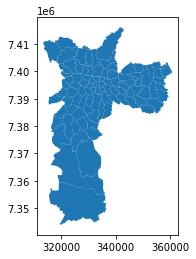

In [5]:
sp_shp.plot()

In [7]:
# Área em km²
sp_shp['area'] = sp_shp.area / 10**6

In [8]:
# Áreas dos distritos
# https://www.prefeitura.sp.gov.br/cidade/secretarias/subprefeituras/subprefeituras/dados_demograficos/index.php?p=12758
sp_shp[['NOME_DIST', 'area']]

,NOME_DIST,area
0,JOSE BONIFACIO,14.570803
1,JD SAO LUIS,26.047200
2,ARTUR ALVIM,6.506837
3,JAGUARA,4.575567
4,VILA PRUDENTE,9.583361
5,JAGUARE,6.528525
6,JARAGUA,28.329686
7,JD HELENA,9.143789
8,JD PAULISTA,6.186069
9,LAJEADO,8.814295


In [2]:
# https://www.ibge.gov.br/geociencias/downloads-geociencias.html?caminho=recortes_para_fins_estatisticos/malha_de_setores_censitarios/censo_2010/base_de_faces_de_logradouros_versao_2020
# https://www.ibge.gov.br/geociencias/organizacao-do-territorio/malhas-territoriais/28971-base-de-faces-de-logradouros-do-brasil.html?=&t=saiba-mais-edicao

sp_log_shp = gpd.read_file('C:/Users/Ricardo/Documents/R-Projetos/Exploratory-Data-Analysis-Bancarization/data/raw/3550308_faces_de_logradouros_2020.shp')

In [3]:
sp_log_shp

,CD_SETOR,CD_QUADRA,CD_FACE,NM_TIP_LOG,NM_TIT_LOG,NM_LOG,TOT_RES,TOT_GERAL,geometry
0,355030801000001,None,None,None,None,None,None,None,"LINESTRING (-46.57027 -23.56791, -46.57053 -23..."
1,355030801000001,None,None,None,None,None,None,None,"LINESTRING (-46.57027 -23.56791, -46.57036 -23..."
2,355030801000001,001,001,None,None,None,12,22,"LINESTRING (-46.56963 -23.56669, -46.56964 -23..."
3,355030801000001,001,002,None,None,None,3,3,"LINESTRING (-46.56963 -23.56669, -46.57018 -23..."
4,355030801000001,001,003,None,None,None,7,7,"LINESTRING (-46.56963 -23.56673, -46.57018 -23..."
...,...,...,...,...,...,...,...,...,...
322175,355030896000339,002,003,None,None,None,0,0,"LINESTRING (-46.41224 -23.52605, -46.41247 -23..."
322176,355030896000339,003,001,None,None,None,0,0,"LINESTRING (-46.41236 -23.52600, -46.41259 -23..."
322177,355030896000339,003,002,None,None,None,0,0,"LINESTRING (-46.41345 -23.52554, -46.41352 -23..."
322178,355030896000339,004,001,None,None,None,0,0,"LINESTRING (-46.41353 -23.52551, -46.41360 -23..."


<AxesSubplot:>

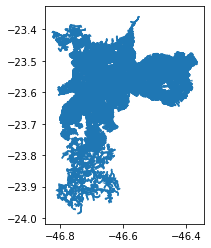

In [6]:
sp_log_shp.plot()

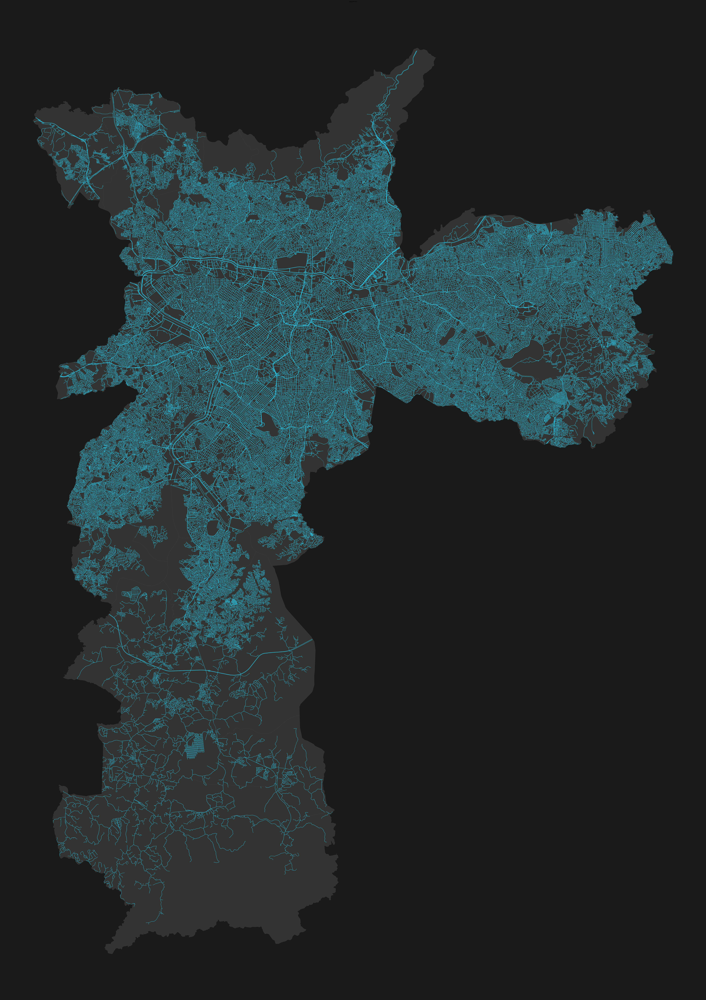

In [57]:
# Create a figure with one subplot
fig, ax = plt.subplots(figsize=(160,154))

# Set bg colors
ax.set(facecolor = "white")
fig.patch.set_facecolor('#191A1A')

# Plot polygons
sp_shp_changed.plot(ax=ax, facecolor='#333332', edgecolor="#454545")

sp_log_shp.plot(ax=ax, color='#2BC8E7', lw=1.0)

# Plot points
#gdf_agencias_sp_points_join.plot(ax=ax, color='blue', markersize=1)

ax.set_title("Logradouro")
ax.axis("off")
plt.show()

In [38]:
sp_log_shp.crs

{'init': 'epsg:4674'}

In [39]:
sp_shp_changed.crs

{'init': 'epsg:4674'}

In [42]:
bela_bista_shp.crs

{'init': 'epsg:4674'}

In [10]:
sp_shp_changed = sp_shp.to_crs(sp_log_shp.crs)

In [11]:
gdf_join = gpd.sjoin(sp_log_shp, sp_shp_changed, predicate='within')

TypeError: sjoin() got an unexpected keyword argument 'predicate'

In [40]:
bela_bista_shp = sp_shp_changed[sp_shp_changed.NOME_DIST == 'BELA VISTA']

<AxesSubplot:>

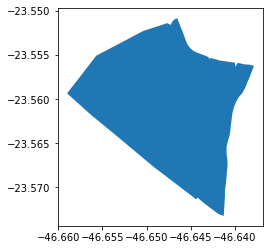

In [41]:
bela_bista_shp.plot()

In [45]:
gdf_belavista_join = gpd.sjoin(sp_log_shp, bela_bista_shp)

AttributeError: 'NoneType' object has no attribute '_geom'

<AxesSubplot:>

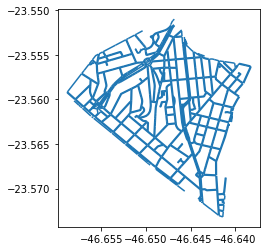

In [49]:
gdf_belavista.plot()

In [33]:
gdf_belavista_join.head()  

,CD_SETOR,CD_QUADRA,CD_FACE,NM_TIP_LOG,NM_TIT_LOG,NM_LOG,TOT_RES,TOT_GERAL,geometry,index_right,CLASSID,FEATID,REVISIONNU,NOME_DIST,SIGLA_DIST,COD_DIST,COD_SUB,DATA_CRIAC,USUARIO_ID,area


In [48]:
gdf_belavista= sp_log_shp[sp_log_shp.geometry.within(bela_bista_shp.geometry.unary_union)]

In [52]:
gdf_belavista

,CD_SETOR,CD_QUADRA,CD_FACE,NM_TIP_LOG,NM_TIT_LOG,NM_LOG,TOT_RES,TOT_GERAL,geometry
14096,355030807000004,None,None,None,None,None,None,None,"LINESTRING (-46.64482 -23.56605, -46.64488 -23..."
14097,355030807000004,None,None,None,None,None,None,None,"LINESTRING (-46.64508 -23.56494, -46.64511 -23..."
14098,355030807000004,None,None,None,None,None,None,None,"LINESTRING (-46.64506 -23.56502, -46.64506 -23..."
14099,355030807000004,None,None,None,None,None,None,None,"LINESTRING (-46.64573 -23.56333, -46.64572 -23..."
14100,355030807000004,002,001,None,None,None,0,1,"LINESTRING (-46.64602 -23.56368, -46.64579 -23..."
14101,355030807000004,002,002,None,None,None,203,208,"LINESTRING (-46.64482 -23.56605, -46.64485 -23..."
14102,355030807000005,001,001,None,None,None,0,3,"LINESTRING (-46.64488 -23.56612, -46.64491 -23..."
14103,355030807000005,001,002,None,None,None,129,133,"LINESTRING (-46.64518 -23.56647, -46.64642 -23..."
14104,355030807000005,001,003,None,None,None,2,8,"LINESTRING (-46.64587 -23.56500, -46.64595 -23..."
14105,355030807000005,001,004,None,None,None,6,7,"LINESTRING (-46.64590 -23.56492, -46.64601 -23..."


In [59]:
# Create a figure with one subplot
fig, ax = plt.subplots(figsize=(160,154))

# Set bg colors
ax.set(facecolor = "white")
fig.patch.set_facecolor('#191A1A')

# Plot polygons
#bela_bista_shp.plot(ax=ax, facecolor='#333332', edgecolor="#454545")

gdf_belavista[gdf_belavista.NM_LOG=='PAULISTA'].plot(ax=ax, color='#2BC8E7', lw=2.0)

# Plot points
#gdf_agencias_sp_points_join.plot(ax=ax, color='blue', markersize=1)

ax.set_title("Logradouro")
ax.axis("off")
plt.show()